In [ ]:
pip install torch torchvision numpy opencv-python matplotlib seaborn scikit-learn tqdm


# Environment Setup and Configuration

In [ ]:
import os
import random
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader
import cv2
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter


from google.colab import drive
drive.mount('/content/drive')

# Paths
DATA_DIR = '/content/drive/MyDrive/UCF101/UCF-101'
MODEL_WEIGHTS_PATH = '/content/drive/MyDrive/UCF101/checkpoints/best_model_trivialaugment.pth'

# Parameters
NUM_CLASSES = 101
BATCH_SIZE = 1
NUM_FRAMES = 16
FRAME_SIZE = (112, 112)
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define multiple target layers with corresponding labels
TARGET_LAYERS = {
    'layer1.2.conv3': 'Early layer',
    'layer2.2.conv3': 'Mid layer',
    'layer3.2.conv3': 'Deep layer',
    'layer4.2.conv3': 'Very deep layer'
}

# Normalization parameters
MEAN = [0.43216, 0.394666, 0.37645]
STD = [0.22803, 0.22145, 0.216989]

# Visualization parameters
FRAMES_TO_PLOT = [0, 5, 10, 15]

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Setting the Random Seed

In [ ]:
def set_seed(seed=42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)

    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)

    # Configure CUDA for deterministic behavior
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

set_seed(42)
print("Random seed set to 42.")

Random seed set to 42.


# Utility Functions
 helper functions for unnormalizing tensors and other utility tasks required for visualization.

In [ ]:
def unnormalize(tensor, mean, std):

    # Adjust mean and std based on tensor dimension
    if tensor.dim() == 3:
        mean = torch.tensor(mean).view(-1, 1, 1).to(tensor.device)
        std = torch.tensor(std).view(-1, 1, 1).to(tensor.device)
    elif tensor.dim() == 4:

        mean = torch.tensor(mean).view(-1, 1, 1, 1).to(tensor.device)
        std = torch.tensor(std).view(-1, 1, 1, 1).to(tensor.device)
    else:
        raise ValueError(f"Expected tensor with 3 or 4 dimensions, got {tensor.dim()} dimensions.")

    tensor = tensor.clone()
    tensor = tensor * std + mean
    return tensor

# Dataset definition
VideoDataset class to handle video loading, frame sampling, and preprocessing.

In [ ]:
class VideoDataset(Dataset):
    def __init__(self, videos, data_dir, transform=None, num_frames=16, frame_size=(112, 112)):
        self.videos = videos
        self.data_dir = data_dir
        self.transform = transform
        self.num_frames = num_frames
        self.frame_size = frame_size

    def __len__(self):
        return len(self.videos)

    def _load_video(self, video_path):
        full_path = os.path.join(self.data_dir, video_path)

        if not os.path.exists(full_path):
            print(f"Warning: Video file does not exist: {full_path}")

            # Create a list of empty frames if the video does not exist
            frame_np = np.zeros((self.frame_size[0], self.frame_size[1], 3), dtype=np.uint8)
            frames = [frame_np] * self.num_frames
        else:
            cap = cv2.VideoCapture(full_path)
            if not cap.isOpened():
                print(f"Warning: Unable to open video: {full_path}")

                # Create a list of empty frames if the video cannot be opened
                frame_np = np.zeros((self.frame_size[0], self.frame_size[1], 3), dtype=np.uint8)
                frames = [frame_np] * self.num_frames
            else:
                frames = []
                last_frame_np = None
                total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

                if total_frames <= 0:
                    print(f"Warning: Video {full_path} has no frames.")

                    # Create a list of empty frames if the video has no frames
                    frame_np = np.zeros((self.frame_size[0], self.frame_size[1], 3), dtype=np.uint8)
                    frames = [frame_np] * self.num_frames
                else:
                    if total_frames < self.num_frames:
                        frame_indices = list(range(total_frames)) + [total_frames - 1] * (self.num_frames - total_frames)
                    else:
                        frame_indices = np.linspace(0, total_frames - 1, self.num_frames, dtype=int)

                    for idx in frame_indices:
                        cap.set(cv2.CAP_PROP_POS_FRAMES, idx)
                        ret, frame = cap.read()
                        if not ret:
                            if last_frame_np is not None:
                                frame_np = last_frame_np
                            else:
                                frame_np = np.zeros((self.frame_size[0], self.frame_size[1], 3), dtype=np.uint8)
                        else:

                          # Convert BGR to RGB and resize the frame
                            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
                            frame = cv2.resize(frame, self.frame_size)
                            frame_np = frame
                            last_frame_np = frame_np

                        frame_tensor = transforms.ToTensor()(frame_np)
                        frames.append(frame_tensor)

                    cap.release()

                    if len(frames) != self.num_frames:
                        print(f"Warning: Video {full_path} has {len(frames)} frames instead of {self.num_frames}.")
                        while len(frames) < self.num_frames:
                            frames.append(frames[-1] if frames else torch.zeros(3, self.frame_size[0], self.frame_size[1]))

        video = torch.stack(frames, dim=1)
        return video

    def __getitem__(self, idx):
        video_path, label = self.videos[idx]
        video = self._load_video(video_path)

        if self.transform:
            video = self.transform(video)

        label = torch.tensor(label, dtype=torch.long)
        return video, label

# Model definition
3D ResNet architecture, including the Bottleneck3D and ResNet3D classes, tailored for video data.

In [ ]:
class Bottleneck3D(nn.Module):
    expansion = 4

    def __init__(self, in_channels, out_channels, stride=1, downsample=None):
        super(Bottleneck3D, self).__init__()
        mid_channels = out_channels // self.expansion

        # 1x1x1 Conv
        self.conv1 = nn.Conv3d(in_channels, mid_channels, kernel_size=1, bias=False)
        self.bn1 = nn.BatchNorm3d(mid_channels)

        # 3x3x3 Depthwise Separable Conv
        self.conv2 = nn.Conv3d(mid_channels, mid_channels, kernel_size=3, stride=stride,
                               padding=1, groups=mid_channels, bias=False)  # Depthwise
        self.conv2_pointwise = nn.Conv3d(mid_channels, mid_channels, kernel_size=1, bias=False)  # Pointwise
        self.bn2 = nn.BatchNorm3d(mid_channels)

        # 1x1x1 Conv
        self.conv3 = nn.Conv3d(mid_channels, out_channels, kernel_size=1, bias=False)
        self.bn3 = nn.BatchNorm3d(out_channels)

        self.relu = nn.ReLU(inplace=True)
        self.downsample = downsample

    def forward(self, x):
        identity = x

        # Bottleneck
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        # Depthwise Separable Conv
        out = self.conv2(out)
        out = self.conv2_pointwise(out)
        out = self.bn2(out)
        out = self.relu(out)

        # 1x1x1 Conv
        out = self.conv3(out)
        out = self.bn3(out)

        # Downsampling
        if self.downsample is not None:
            identity = self.downsample(x)

        # Residual Connection
        out += identity
        out = self.relu(out)

        return out

class ResNet3D(nn.Module):
    def __init__(self, block, layers, num_classes=101, in_channels=3):
        super(ResNet3D, self).__init__()
        self.in_channels = 64

        # Initial Convolution and Pooling
        self.conv1 = nn.Conv3d(in_channels, 64, kernel_size=(3, 7, 7),
                               stride=(1, 2, 2), padding=(1, 3, 3), bias=False)
        self.bn1 = nn.BatchNorm3d(64)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool3d(kernel_size=(1, 3, 3), stride=(1, 2, 2), padding=(0, 1, 1))

        # Residual Layers
        self.layer1 = self._make_layer(block, 256, layers[0], stride=1)
        self.layer2 = self._make_layer(block, 512, layers[1], stride=2)
        self.layer3 = self._make_layer(block, 1024, layers[2], stride=2)
        self.layer4 = self._make_layer(block, 2048, layers[3], stride=2)

        # Classification Head
        self.avgpool = nn.AdaptiveAvgPool3d((1, 1, 1))
        self.fc = nn.Linear(2048, num_classes)

        # Initialize weights
        self._initialize_weights()

    def _make_layer(self, block, out_channels, blocks, stride=1):
        downsample = None
        if stride != 1 or self.in_channels != out_channels:
            downsample = nn.Sequential(
                nn.Conv3d(self.in_channels, out_channels, kernel_size=1,
                          stride=stride, bias=False),
                nn.BatchNorm3d(out_channels),
            )

        layers = []
        layers.append(block(self.in_channels, out_channels, stride, downsample))
        self.in_channels = out_channels
        for _ in range(1, blocks):
            layers.append(block(self.in_channels, out_channels))

        return nn.Sequential(*layers)

    def forward(self, x):

        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        x = self.avgpool(x)
        x = x.view(x.size(0), -1)
        x = self.fc(x)

        return x

    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv3d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, nn.BatchNorm3d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)

def resnet3d_50(num_classes=101, in_channels=3):
    layers = [3, 4, 6, 3]  # Similar to ResNet-50
    model = ResNet3D(Bottleneck3D, layers, num_classes=num_classes, in_channels=in_channels)
    return model

# Grad-CAM Implementation
Grad-CAM algorithm tailored for 3D models by capturing activations and gradients from target layers.

In [ ]:
class GradCAM3D:
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradients = None
        self.activations = None

        # Register hooks
        self.forward_handle = target_layer.register_forward_hook(self.save_activation)
        self.backward_handle = target_layer.register_full_backward_hook(self.save_gradient)

    def save_activation(self, module, input, output):
        self.activations = output.detach()

    def save_gradient(self, module, grad_input, grad_output):
        self.gradients = grad_output[0].detach()

    def generate_cam(self, class_idx=None):
        # Gradient and activation should be set after a backward pass.
        if self.gradients is None or self.activations is None:
            raise ValueError("Gradients and activations have not been set. Perform a backward pass first.")

        B, C, T, H, W = self.activations.shape
        # Mean gradient over each channel
        alpha = self.gradients.view(B, C, -1).mean(dim=2)  # [B, C]

        # Weight channels by alpha
        weights = alpha.view(B, C, 1, 1, 1)
        cam = (weights * self.activations).sum(dim=1)  # [B, T, H, W]

        # ReLU on cam
        cam = F.relu(cam)

        # Normalize CAM
        cam_min = cam.view(B, -1).min(dim=1, keepdim=True)[0]
        cam_max = cam.view(B, -1).max(dim=1, keepdim=True)[0]
        cam = (cam - cam_min.unsqueeze(-1)) / (cam_max.unsqueeze(-1) + 1e-8)

        return cam


# Data Preparation
Load class mappings, collect video paths, split the dataset into training, validation, and testing sets, and filter videos based on selected classes.

In [ ]:
def get_class_to_idx(data_dir):

    # Retrieve sorted list of class names
    classes = sorted([d for d in os.listdir(data_dir) if os.path.isdir(os.path.join(data_dir, d))])
    class_to_idx = {cls_name: idx for idx, cls_name in enumerate(classes)}
    idx_to_class = {idx: cls_name for cls_name, idx in class_to_idx.items()}
    return class_to_idx, idx_to_class

# Generate class-to-index mappings
class_to_idx, idx_to_class = get_class_to_idx(DATA_DIR)
print(f"Number of classes: {len(class_to_idx)}")
print("First 5 class mappings:")
for cls_name, idx in list(class_to_idx.items())[:5]:
    print(f"{cls_name}: {idx}")

def get_all_videos(data_dir, class_to_idx):
    video_list = []

    # Iterate through each class directory
    for class_name in os.listdir(data_dir):
        class_path = os.path.join(data_dir, class_name)
        if not os.path.isdir(class_path):
            continue

        # Iterate through each video file in the class directory
        for video_name in os.listdir(class_path):
            if video_name.endswith(('.avi', '.mp4', '.mov', '.mkv')):
                video_path = os.path.join(class_name, video_name)
                label = class_to_idx[class_name]
                video_list.append((video_path, label))
    return video_list

all_videos = get_all_videos(DATA_DIR, class_to_idx)
print(f"Total number of videos found: {len(all_videos)}")

train_ratio = 0.7
val_ratio = 0.15
test_ratio = 0.15

train_videos, temp_videos = train_test_split(
    all_videos,
    test_size=(1 - train_ratio),
    stratify=[label for _, label in all_videos],
    random_state=42
)

# Further split the temporary set into validation and testing sets
val_videos, test_videos = train_test_split(
    temp_videos,
    test_size=(test_ratio / (test_ratio + val_ratio)),
    stratify=[label for _, label in temp_videos],
    random_state=42
)

print(f"Number of training videos: {len(train_videos)}")
print(f"Number of validation videos: {len(val_videos)}")
print(f"Number of testing videos: {len(test_videos)}")

selected_class_to_idx = class_to_idx
selected_idx_to_class = idx_to_class

def filter_videos_by_classes(videos, selected_class_to_idx):
    filtered_videos = []
    for video_path, label in videos:
        class_name = video_path.split('/')[0]
        if class_name in selected_class_to_idx:
            new_label = selected_class_to_idx[class_name]
            filtered_videos.append((video_path, new_label))
    return filtered_videos

train_videos_filtered = filter_videos_by_classes(train_videos, selected_class_to_idx)
val_videos_filtered = filter_videos_by_classes(val_videos, selected_class_to_idx)
test_videos_filtered = filter_videos_by_classes(test_videos, selected_class_to_idx)

print(f"Number of training videos after filtering: {len(train_videos_filtered)}")
print(f"Number of validation videos after filtering: {len(val_videos_filtered)}")
print(f"Number of testing videos after filtering: {len(test_videos_filtered)}")

Number of classes: 101
First 5 class mappings:
ApplyEyeMakeup: 0
ApplyLipstick: 1
Archery: 2
BabyCrawling: 3
BalanceBeam: 4
Total number of videos found: 13320
Number of training videos: 9323
Number of validation videos: 1998
Number of testing videos: 1999
Number of training videos after filtering: 9323
Number of validation videos after filtering: 1998
Number of testing videos after filtering: 1999


# Tranfsormations and DataLoaders
data transformations for preprocessing and create DataLoader instances for the test dataset.

In [ ]:
class NormalizeVideo:
    """
    Applies normalization to each frame in the video tensor.
    """
    def __init__(self, mean, std):
        self.normalize = transforms.Normalize(mean=mean, std=std)

    def __call__(self, video):
        C, T, H, W = video.shape
        for t in range(T):
            # Normalize each frame individually
            video[:, t, :, :] = self.normalize(video[:, t, :, :])
        return video

class CenterCropVideo:
    """
    Applies center crop to the video tensor.
    """
    def __init__(self, size):
        self.size = size

    def __call__(self, video):
        C, T, H, W = video.shape
        new_H, new_W = self.size

        # Calculate top and left coordinates for cropping
        top = (H - new_H) // 2 if H > new_H else 0
        left = (W - new_W) // 2 if W > new_W else 0

        # center cropping
        video = video[:, :, top:top + new_H, left:left + new_W]
        return video

# Define the transform pipeline for validation and testing
test_transforms = transforms.Compose([
    CenterCropVideo(size=(112, 112)),
    NormalizeVideo(mean=MEAN, std=STD),
])

test_dataset = VideoDataset(
    videos=test_videos_filtered,
    data_dir=DATA_DIR,
    transform=test_transforms,
    num_frames=NUM_FRAMES,
    frame_size=FRAME_SIZE
)

test_loader = DataLoader(
    test_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=2,
    pin_memory=True
)

print(f"Test dataset size: {len(test_dataset)}")


Test dataset size: 1999


# Model Loading
Initialize the 3D ResNet model and load the pre-trained weights from the specified checkpoint.

In [ ]:
model = resnet3d_50(num_classes=NUM_CLASSES, in_channels=3)

if os.path.exists(MODEL_WEIGHTS_PATH):
    checkpoint = torch.load(MODEL_WEIGHTS_PATH, map_location=DEVICE)
    if isinstance(checkpoint, dict) and 'state_dict' in checkpoint:
        model.load_state_dict(checkpoint['state_dict'])
    else:
        model.load_state_dict(checkpoint)
    print(f"Model weights loaded from {MODEL_WEIGHTS_PATH}")
else:
    raise FileNotFoundError(f"Model weights not found at {MODEL_WEIGHTS_PATH}")

model.to(DEVICE)
model.eval()
print("Model loaded and moved to device.")

<ipython-input-41-22172074983d>:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(MODEL_WEIGHTS_PATH, map_location=DEVICE)


Model weights loaded from /content/drive/MyDrive/UCF101/checkpoints/best_model_trivialaugment.pth
Model loaded and moved to device.


# Define Class Names
list of class names based on the index-to-class mapping for easier interpretation during visualization.

In [ ]:
class_names = [selected_idx_to_class[i] for i in range(NUM_CLASSES)]

# Initialize Grad-CAM Instances
Set up Grad-CAM instances for multiple target layers to visualize attention at different depths of the network.

In [ ]:
# Helper function to get target layer by name
def get_target_layer(model, layer_name):
    layers = layer_name.split('.')
    target_layer = model
    for layer in layers:
        if layer.isdigit():
            target_layer = target_layer[int(layer)]
        else:
            target_layer = getattr(target_layer, layer)
    return target_layer

# Initialize Grad-CAM for each target layer
gradcam_instances = {}
for layer_name in TARGET_LAYERS.keys():
    try:
        target_layer_module = get_target_layer(model, layer_name)
    except AttributeError as e:
        print(f"Error accessing target layer '{layer_name}': {e}")
        continue
    gradcam = GradCAM3D(model, target_layer_module)
    gradcam_instances[layer_name] = gradcam
    print(f"Grad-CAM initialized on layer: {layer_name}")


Grad-CAM initialized on layer: layer1.2.conv3
Grad-CAM initialized on layer: layer2.2.conv3
Grad-CAM initialized on layer: layer3.2.conv3
Grad-CAM initialized on layer: layer4.2.conv3


# Select 10 samples from 10 different classes


In [ ]:
# Create a dictionary to hold one sample per class
samples_per_class = {}
for video_path, label in test_videos_filtered:
    if label not in samples_per_class:
        samples_per_class[label] = video_path
    if len(samples_per_class) >= 10:
        break

if len(samples_per_class) < 10:
    print("Warning: Less than 10 classes available in the test set.")

# Grad-CAM Processing and Visualization
Iterate over the selected samples, perform Grad-CAM for each target layer, and visualize the resulting heatmaps overlayed on the original video frames.


Processing class: VolleyballSpiking (Label: 96)
Predicted class: VolleyballSpiking
True class: VolleyballSpiking


/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:825: UserWarning: Attempting to run cuBLAS, but there was no current CUDA context! Attempting to set the primary context... (Triggered internally at ../aten/src/ATen/cuda/CublasHandlePool.cpp:135.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


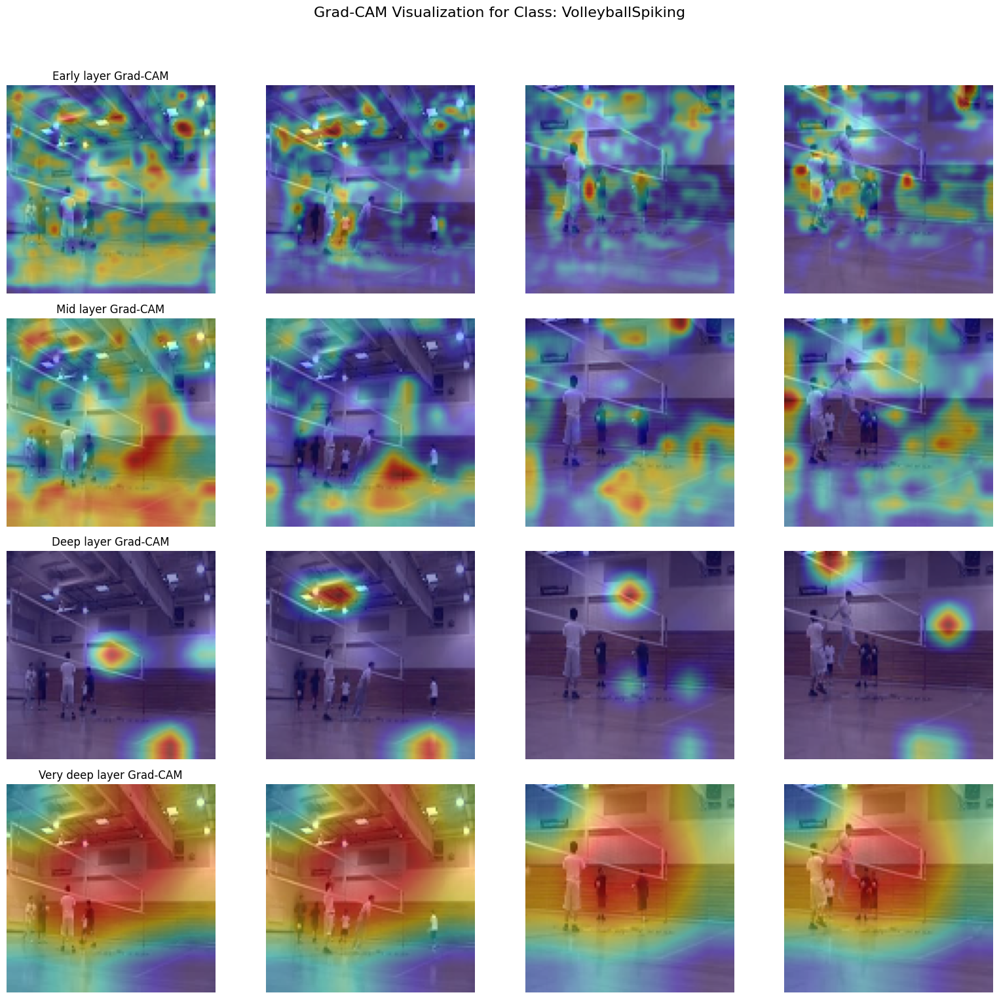


Processing class: SoccerPenalty (Label: 84)
Predicted class: SoccerPenalty
True class: SoccerPenalty


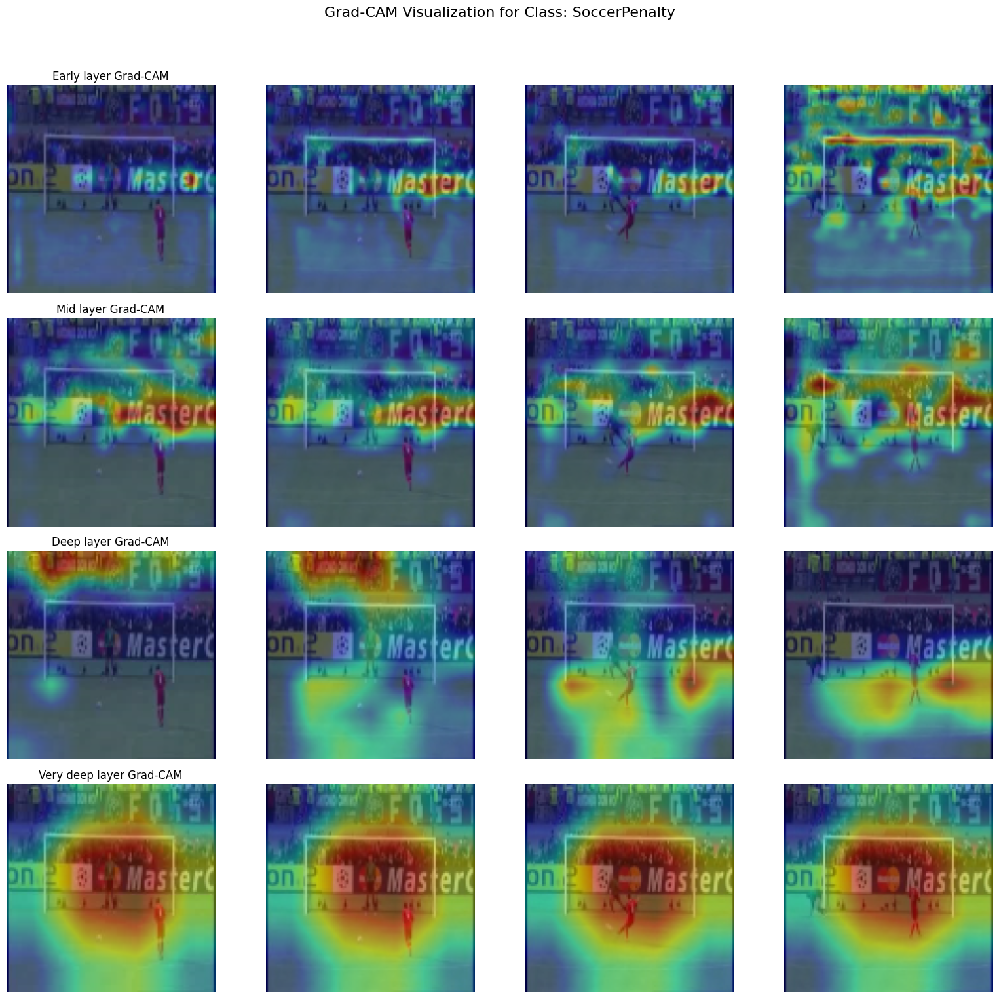


Processing class: SumoWrestling (Label: 86)
Predicted class: BasketballDunk
True class: SumoWrestling


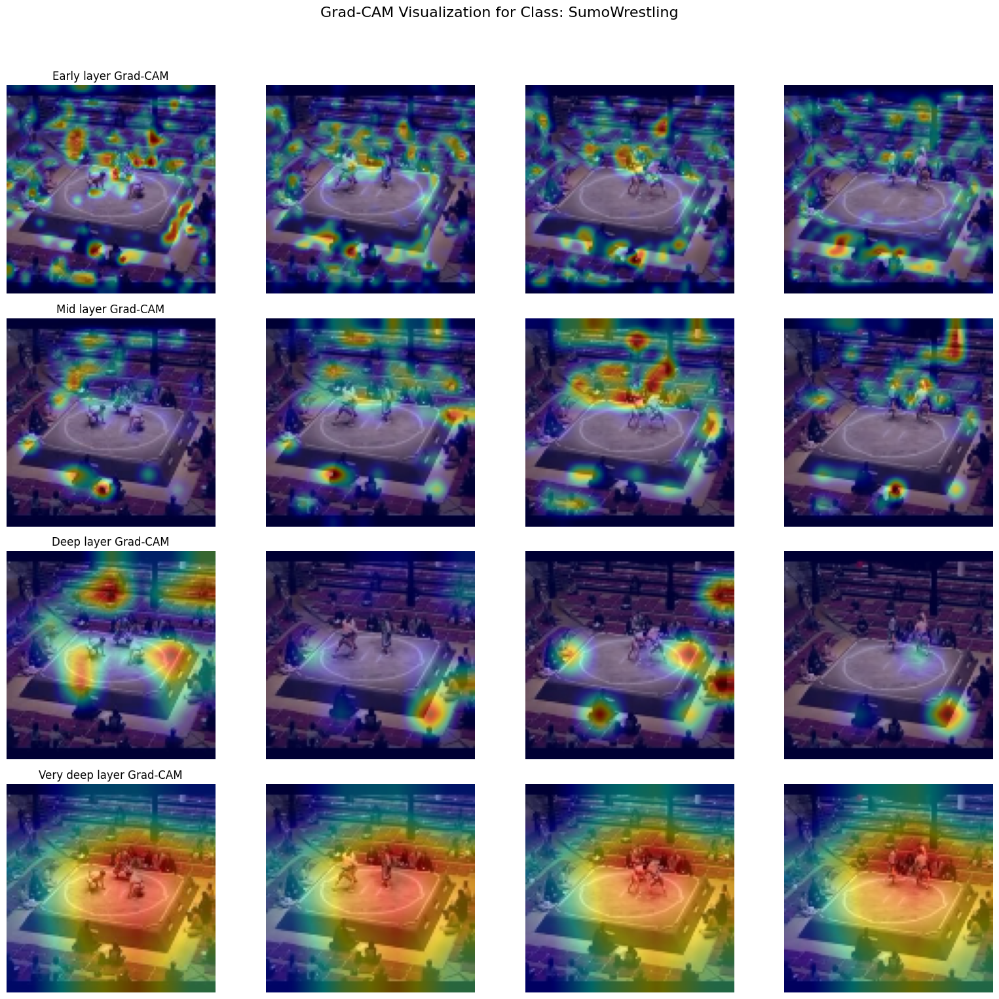


Processing class: PoleVault (Label: 67)
Predicted class: Skijet
True class: PoleVault


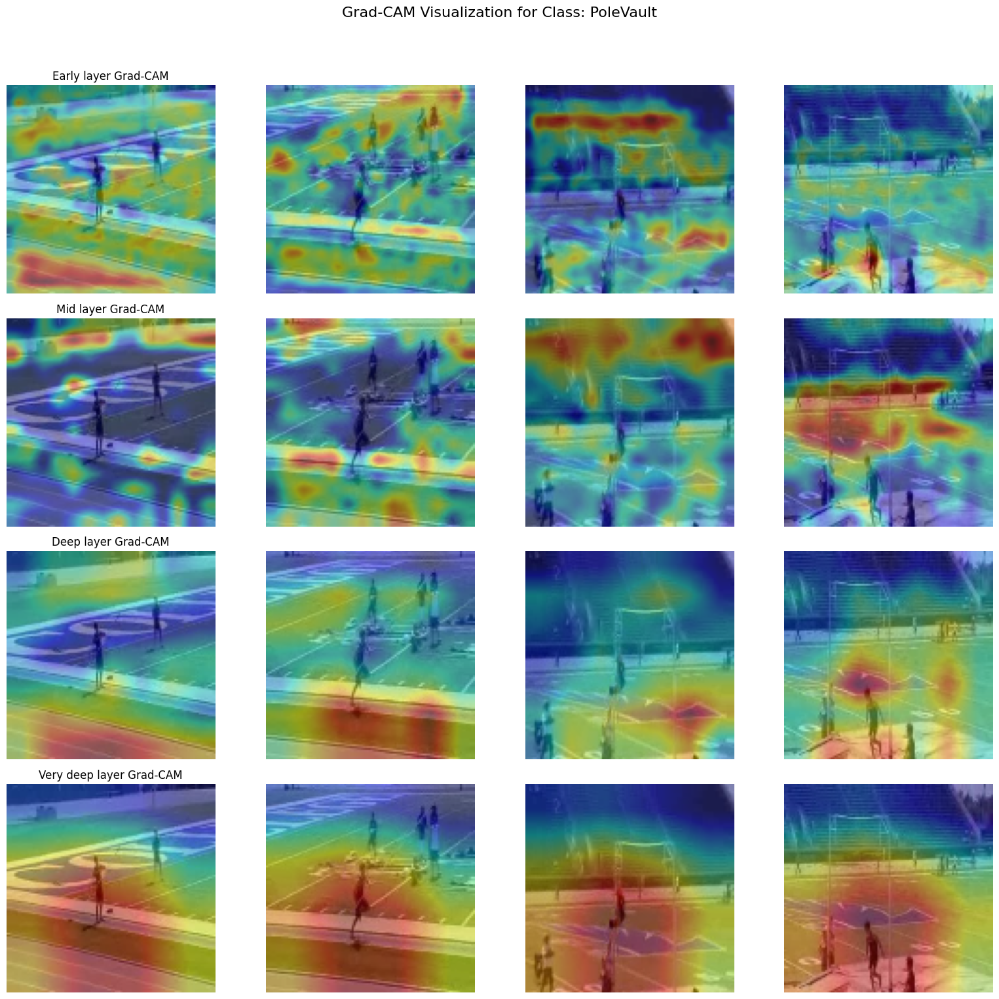


Processing class: BrushingTeeth (Label: 19)
Predicted class: BrushingTeeth
True class: BrushingTeeth


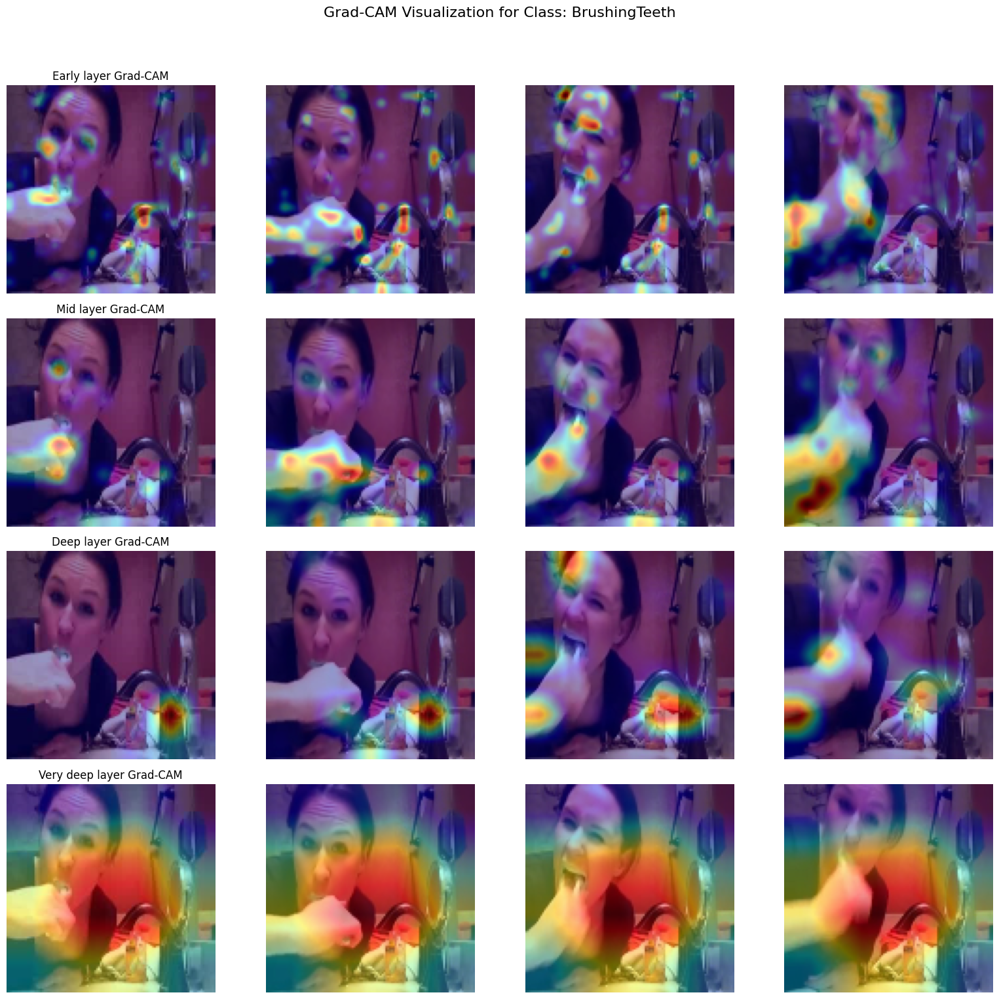


Processing class: Billiards (Label: 11)
Predicted class: Billiards
True class: Billiards


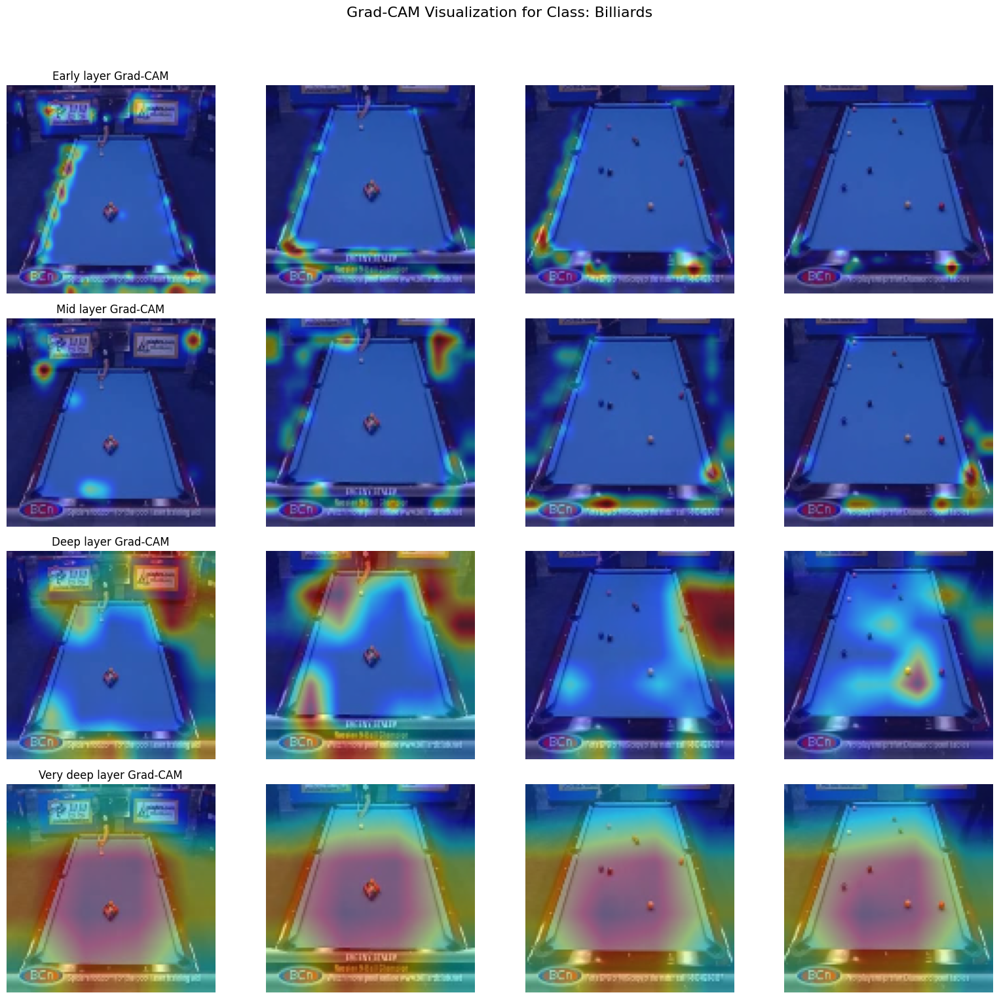


Processing class: HighJump (Label: 39)
Predicted class: VolleyballSpiking
True class: HighJump


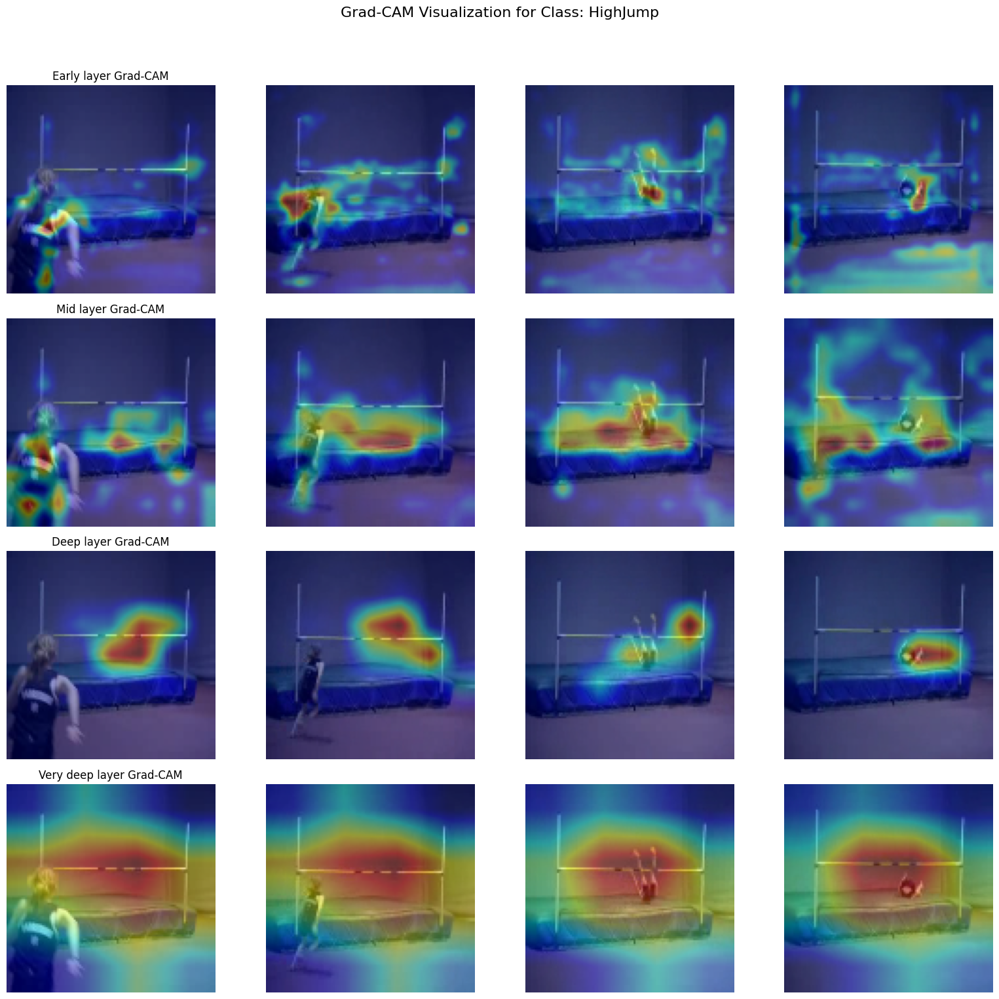


Processing class: WallPushups (Label: 98)
Predicted class: WallPushups
True class: WallPushups


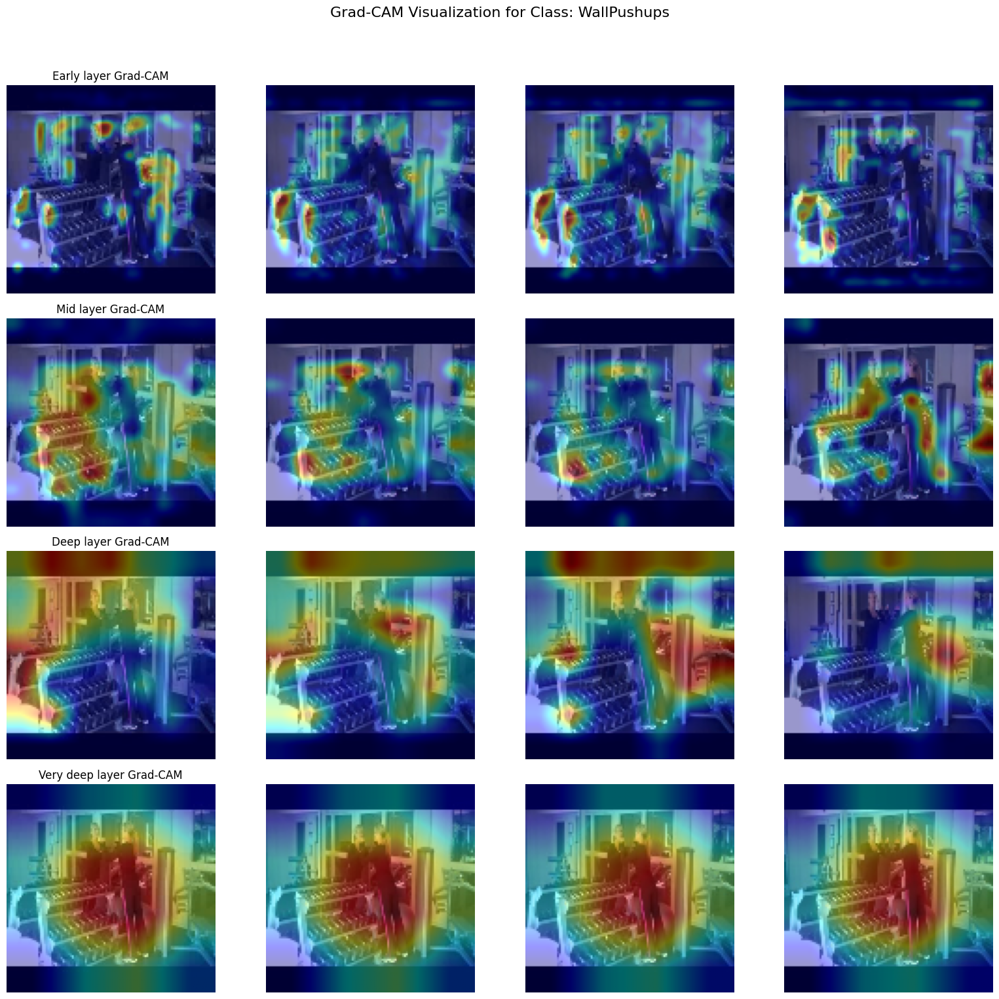


Processing class: PullUps (Label: 69)
Predicted class: PullUps
True class: PullUps


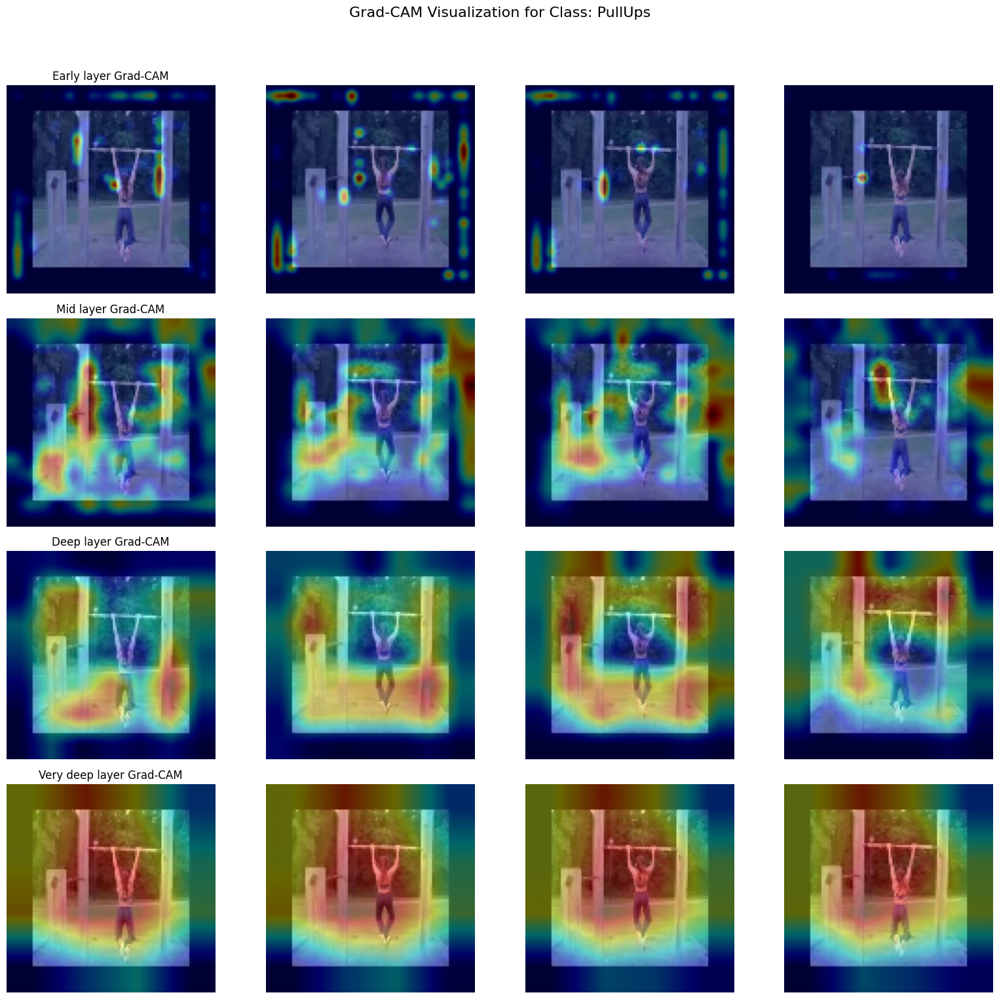


Processing class: Haircut (Label: 33)
Predicted class: Haircut
True class: Haircut


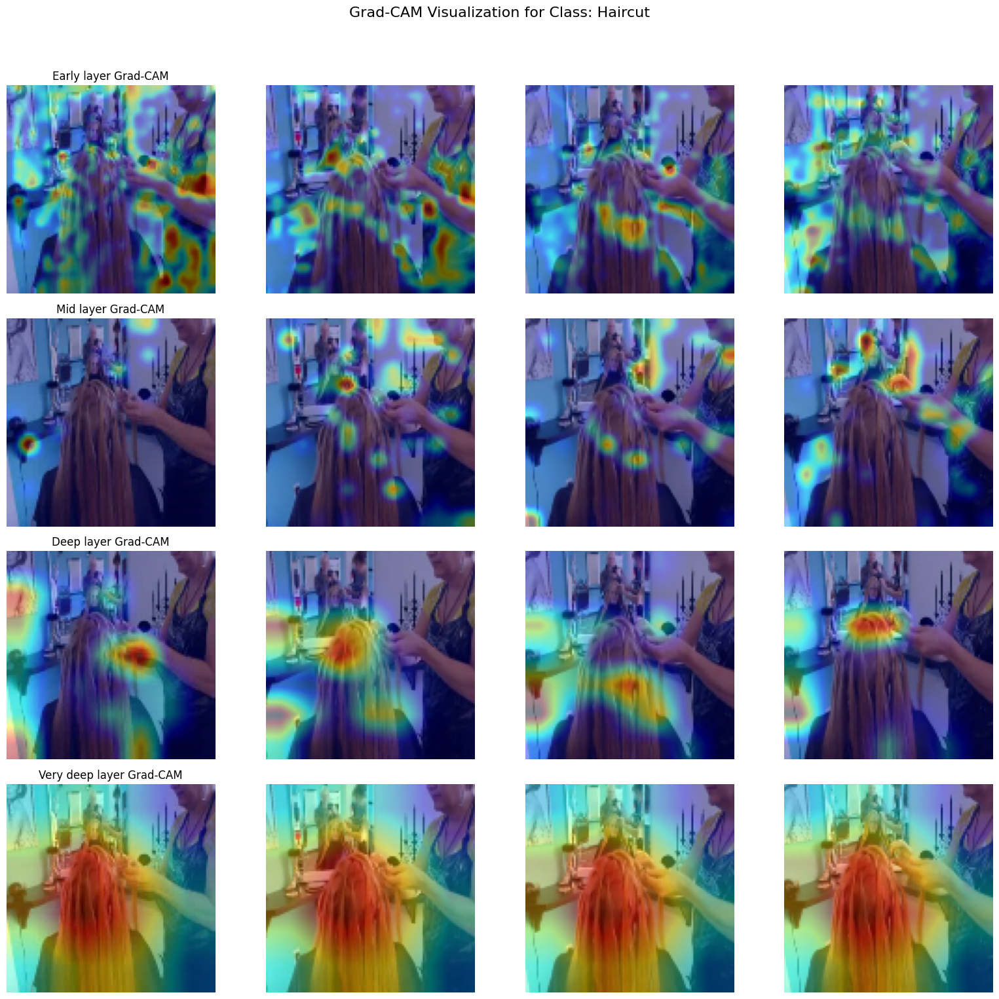

In [ ]:
for label, video_path in samples_per_class.items():
  class_name = class_names[label]
  print(f"\nProcessing class: {class_name} (Label: {label})")

  # Find the index of the video in the test_dataset
  video_index = test_videos_filtered.index((video_path, label))
  video, video_label = test_dataset[video_index]
  video = video.unsqueeze(0).to(DEVICE)

  # Forward pass
  outputs = model(video)
  preds = torch.argmax(outputs, dim=1)

  # Select the first sample in the batch
  sample_idx = 0
  pred_class = preds[sample_idx].item()
  true_class = video_label.item()

  print(f"Predicted class: {class_names[pred_class]}")
  print(f"True class: {class_names[true_class]}")


  model.zero_grad()
  one_hot = torch.zeros_like(outputs)
  one_hot[0, pred_class] = 1
  outputs.backward(gradient=one_hot, retain_graph=True)

  # Generate Grad-CAMs for each target layer
  cams = {}
  cam_stats = {}
  for layer_name, gradcam in gradcam_instances.items():
      try:
          cam = gradcam.generate_cam(class_idx=pred_class)
          # Upsample CAM to match the input temporal and spatial dimensions
          upsampled_cam = F.interpolate(cam.unsqueeze(1), size=(NUM_FRAMES, FRAME_SIZE[0], FRAME_SIZE[1]),
                                        mode='trilinear', align_corners=False)
          cam_sample = upsampled_cam.squeeze(1)[sample_idx].detach().cpu().numpy()

          # Apply Gaussian blur to the CAM to reduce pixelation
          cam_sample_blurred = np.zeros_like(cam_sample)
          for t in range(NUM_FRAMES):
              cam_sample_blurred[t] = gaussian_filter(cam_sample[t], sigma=1)

          cams[layer_name] = cam_sample_blurred


          cam_min = cam_sample_blurred.min()
          cam_max = cam_sample_blurred.max()
          cam_stats[layer_name] = {'min': cam_min, 'max': cam_max}

      except Exception as e:
          print(f"Error generating CAM for layer '{layer_name}': {e}")

  # Retrieve the original video (unnormalized) for visualization
  original_sample = video[sample_idx].detach().cpu()
  unnorm_sample = unnormalize(original_sample, MEAN, STD)
  unnorm_sample = np.clip(unnorm_sample.numpy().transpose(1, 2, 3, 0), 0, 1)


  num_layers = len(cams)
  num_columns = len(FRAMES_TO_PLOT)
  fig, axes = plt.subplots(num_layers, num_columns, figsize=(4*num_columns, 4*num_layers))
  fig.suptitle(f'Grad-CAM Visualization for Class: {class_name}', fontsize=16)

  if num_layers == 1:
      axes = axes[np.newaxis, :]

  for row, (layer_name, cam_sample) in enumerate(cams.items()):
      layer_label = TARGET_LAYERS[layer_name]
      for i, fidx in enumerate(FRAMES_TO_PLOT):
          if fidx >= NUM_FRAMES:
              print(f"Frame index {fidx} is out of bounds for NUM_FRAMES={NUM_FRAMES}. Skipping.")
              axes[row, i].axis('off')
              continue

          frame = unnorm_sample[fidx]
          heatmap = cam_sample[fidx]

          # Resize heatmap to match frame size
          heatmap_resized = cv2.resize(heatmap, (FRAME_SIZE[1], FRAME_SIZE[0]))
          heatmap_normalized = (heatmap_resized - heatmap_resized.min()) / (heatmap_resized.max() - heatmap_resized.min() + 1e-8)
          heatmap_normalized = np.uint8(255 * heatmap_normalized)
          heatmap_color = cv2.applyColorMap(heatmap_normalized, cv2.COLORMAP_JET)
          heatmap_color = cv2.cvtColor(heatmap_color, cv2.COLOR_BGR2RGB)

          # Blend the original frame and heatmap
          overlay = 0.6 * frame + 0.4 * (heatmap_color / 255.0)
          overlay = np.clip(overlay, 0, 1)

          # Original frame
          axes[row, i].imshow(frame)
          axes[row, i].axis('off')
          if i == 0:
              axes[row, i].set_title('Original Frame')

          # Overlay heatmap
          axes[row, i].imshow(overlay)
          axes[row, i].axis('off')
          if i == 0:
              axes[row, i].set_title(f'{layer_label} Grad-CAM')


  plt.tight_layout(rect=[0, 0.03, 1, 0.95])
  plt.show()


  # Clean up Grad-CAM hooks
  for gradcam in gradcam_instances.values():
      del gradcam
